# Notebook to Investigate LSTM Performance Variance by Huc Type - DAssemble Metrics And Data

# Step 0 - Set up Notebook

In [47]:
# import needed libaries
import os
import boto3
import mlflow
import time
from PIL import Image
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from snowML.datapipe import snow_types as st
from snowML.datapipe import get_geos as gg
from snowML.datapipe import data_utils as du
from snowML.datapipe import get_dem as gd

In [48]:
# initialize erathengine credentials
import ee
ee.Authenticate()

True

# Step1 - Get MLFlow Metrics

In [49]:
# function to retrieve metrics from ML server 
def load_ml_metrics(tracking_uri, run_id, save_local=False):
    mlflow.set_tracking_uri(tracking_uri)
    client = mlflow.MlflowClient()
    # Get all metric keys from the run
    run_data = client.get_run(run_id).data
    metric_keys = run_data.metrics.keys()
    # Retrieve full metric history for each key
    all_metrics = []
    for metric in metric_keys:
        history = client.get_metric_history(run_id, metric)
        for record in history:
            all_metrics.append({
                "Metric": metric,
                "Step": record.step,
                "Value": record.value
            })
    
    # Convert to DataFrame
    metrics_df = pd.DataFrame(all_metrics)
    
    # Save to CSV if needed
    if save_local:
        f_out = f"run_id_data/metrics_from_{run_id}.csv"
        metrics_df.to_csv(f_out, index=False)

    return metrics_df

In [50]:
# function to extract only a specific metric
def extract_metric(df, metric_name):
    """Extracts rows where the Metric column ends with 'metric_name' and returns only Metric and Value columns."""
    return df[df['Metric'].str.endswith(metric_name)][['Metric', 'Value']].sort_values(by='Metric')

In [51]:
# function to extract data from a given epoch 
def summarize_by_step(df, step, agg_lev = 12):
    df_filtered = df[df["Step"] == step].copy()
    df_filtered["Metric_Type"] = df_filtered["Metric"].str.extract(r"(test_mse|test_kge|train_mse|train_kge)")
    df_filtered["HUC_ID"] = df_filtered["Metric"].str.extract(fr"(\d{{{agg_lev}}})")  

    # Take mean across HUC_ID if duplicates exist
    if df_filtered.duplicated(subset=["HUC_ID", "Metric_Type"]).any():
        df_filtered = df_filtered.groupby(["HUC_ID", "Metric_Type"], as_index=False)["Value"].mean()

    df_pivot = df_filtered.pivot(index="HUC_ID", columns="Metric_Type", values="Value")
    df_pivot.columns = ["Test KGE", "Test MSE", "Train KGE", "Train_MSE"]
    df_pivot_sorted = df_pivot.sort_index()
    df_selected = df_pivot_sorted[["Test MSE", "Test KGE"]]
    # print(df_selected)
    return df_selected

In [6]:
# set mlFlow tracking server
tracking_uri = "arn:aws:sagemaker:us-west-2:677276086662:mlflow-tracking-server/dawgsML"
# define our run_ids by recognizable names; local training spread over 3 runs 
single_1 = "69d929bbdfdd43b4a2f45b823d945eb7" # ~300 different huc12 units, 10 epochs each, dapper-pig-680 
single_2 = "aca5e4d1b42044a2aeabc055a0b14d8d" # loud-bug
single_3 =  "b0fa8180481a4dc6954f138e9ee934aa" # youthful_pig 

In [7]:
#df_single_1 = load_ml_metrics(tracking_uri, single_1, save_local=True)
#print(df_single_1.shape)
#df_single_1.head(2)

In [8]:
#df_single_2 = load_ml_metrics(tracking_uri, single_2, save_local=True)
#print(df_single_2.shape)
#df_single_2.head(2)

In [9]:
#df_single_3 = load_ml_metrics(tracking_uri, single_3, save_local=True)
#print(df_single_3.shape)
#df_single_3.head(2)

In [10]:
# Concatenate and de_dup
#df_single_all = pd.concat([df_single_1, df_single_2, df_single_3], ignore_index=True)
#df_single_all = df_single_all.drop_duplicates()
#print(df_single_all.shape)
#df_single_all.head(2)


In [11]:
# save the combined metric set 
#f_out = f"run_id_data/metrics_single_all.csv"
#df_single_all.to_csv(f_out, index=False)

In [52]:
# upload from local 
df_all_single = pd.read_csv("run_id_data/metrics_single_all.csv")
print(df_all_single.shape)
df_all_single.head(2)

(21684, 3)


,Metric,Step,Value
0,train_mse_170103040305,0,0.029135
1,train_mse_170103040305,1,0.008264


In [53]:
df9 = summarize_by_step(df_all_single, 9)

In [54]:
df9.head(2)

,Test MSE,Test KGE
HUC_ID,,
170103020101,0.002073,0.893745
170103020102,0.001535,0.936654


In [55]:
def count_huc8(df):
    # Extract the first 10 digits of each huc_id
    huc8_counts = df.index.astype(str).str[:8].value_counts()
    return huc8_counts

In [56]:
huc_8_count = count_huc8(df9).sort_index(ascending=True)

In [57]:
np.sum(huc_8_count)

534

# Step 2 - Plot histogram of test_kge for each epoch 

In [58]:
def plot_test_kge_histogram(df, output_file = "histogram.png"):
    """
    Plots a histogram of the test_kge values from a pandas DataFrame and saves it as 'histogram.png'.
    
    Parameters:
    df (pd.DataFrame): DataFrame containing the column 'test_kge'.
    """
    if 'Test KGE' not in df.columns:
        raise ValueError("DataFrame must contain a 'Test KGE' column")
    
    test_kge_values = df['Test KGE'].dropna()
    median_kge = np.median(test_kge_values)
    
    plt.figure(figsize=(8, 6))
    plt.hist(df['Test KGE'].dropna(), bins=20, edgecolor='black', alpha=0.7)
    plt.axvline(median_kge, color='red', linestyle='dashed', linewidth=2, label=f'Median: {median_kge:.2f}')
    plt.text(median_kge, plt.ylim()[1] * 0.9, f'Median: {median_kge:.2f}', color='red', ha='right', fontsize=12, fontweight='bold')
    plt.xlabel('Test KGE')
    plt.ylabel('Frequency')
    plt.title('Histogram of Test KGE Values')
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.savefig(output_file)
    plt.close()
    return plt


In [59]:
def stepwise_hists(metrics, epochs, f_out):

    temp_files = []

    for epoch in range(epochs): 
        metrics_epoch = summarize_by_step(metrics, epoch, agg_lev=12)  
        temp_file = f"hist_epoch_{epoch}.png"
        plot_test_kge_histogram(metrics_epoch, output_file=temp_file)
        temp_files.append((epoch, temp_file))
    
    # Determine grid size
    num_histograms = len(temp_files)
    cols = 3  # Three per row
    rows = (num_histograms + cols - 1) // cols  # Calculate needed rows

    fig, axes = plt.subplots(rows, cols, figsize=(cols * 6, rows * 5))  # Adjust figure size
    axes = np.array(axes).reshape(rows, cols)  # Ensure axes is always 2D

    for ax in axes.flat:
        ax.axis("off")  # Hide all axes initially

    for (epoch, temp_file), ax in zip(temp_files, axes.flat):
        img = plt.imread(temp_file)  # Load the image
        ax.imshow(img)
        ax.set_title(f"Histograme of Test KGE Values for epoch {epoch}", fontsize=14, fontweight="bold")
        ax.axis("off")  # Hide axis labels

    plt.tight_layout()
    plt.show()
    #f_out = f"kge_hist/{run_id}_all_hists.png"
    plt.savefig(f_out, dpi=300)
    plt.close()

    # Cleanup temporary files
    for _, f in temp_files:
        os.remove(f)

    print(f"Saved combined histogram image as {f_out}")

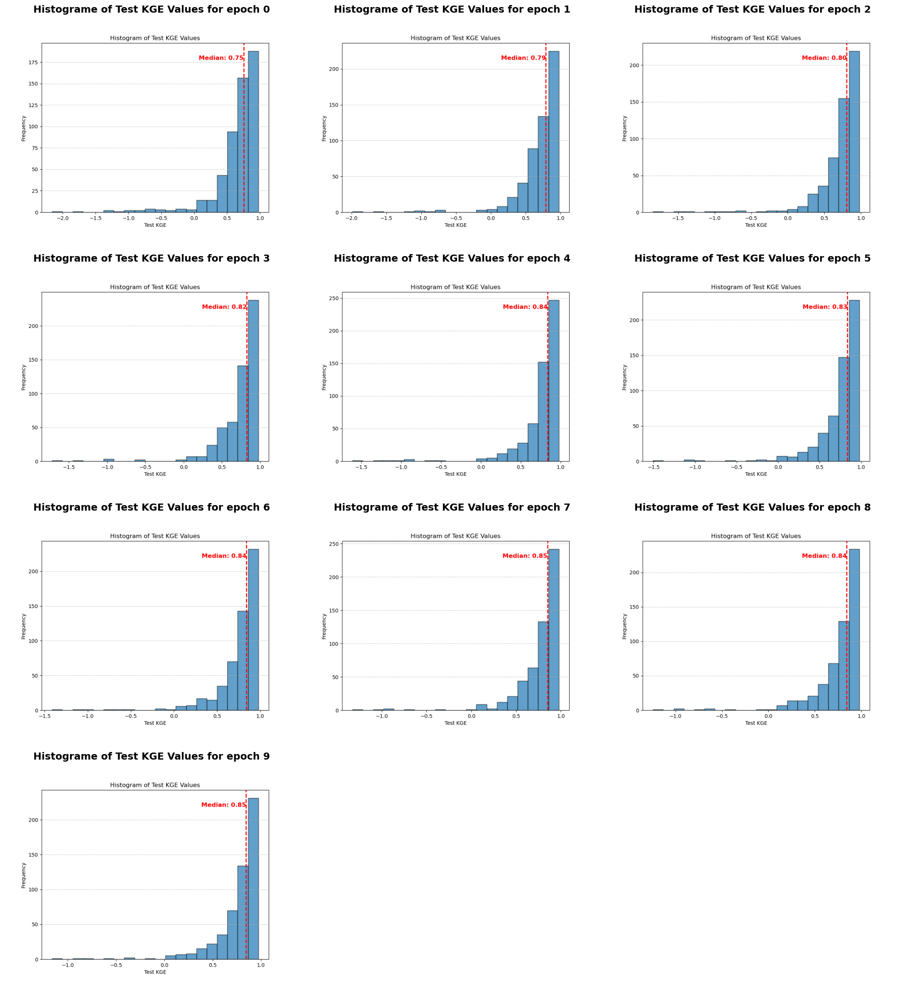

Saved combined histogram image as Stepwise_Histogram_All_Hucs_Singly_Trained


In [60]:
stepwise_hists(df_all_single, 10, "Stepwise_Histogram_All_Hucs_Singly_Trained")

# Step 3 - Extract Last Epoch of Data 

In [21]:
# extract the last epoch of data 
df_all_ep10 =  summarize_by_step(df_all_single, 9, agg_lev = 12)
print(df_all_ep10.shape)
df_all_ep10.head(2)

(534, 2)


,Test MSE,Test KGE
HUC_ID,,
170103020101,0.002073,0.893745
170103020102,0.001535,0.936654


# Step 4 Add in Snow Class Data 

In [22]:
# get the snow class data 
HUC_LIST = [17010302, 17010304,
            17020009, 17020010, 17020011,
            17030001, 17030002, 17030003,
            17060207, 17060208, 
            17110005, 17110006, 17110007, 17110008, 17110009]
HUC_LIST_OF_LISTS = [[huc, '12'] for huc in HUC_LIST]
df_dict = {} 
for input_pair in HUC_LIST_OF_LISTS: 
    #print(f"processing huc {input_pair[0]}")
    _, _, df_predom = st.process_all(input_pair[0], input_pair[1])
    df_dict[input_pair[0]] = df_predom


In [23]:
# combine the dfs
df_list = []
for huc_id, df in df_dict.items():
    df_list.append(df)
df_extra = pd.concat(df_list)
df_extra = df_extra.set_index("huc_id")
print(df_extra.shape)
df_extra.head(2)

(551, 9)


,Tundra,Boreal Forest,Maritime,Ephemeral,Prairie,Montane Forest,Ice,Ocean,Predominant_Snow
huc_id,,,,,,,,,
170103020101,0.0,0.0,0.0,0.0,11.0,89.0,0.0,0.0,Montane Forest
170103020102,0.0,0.0,0.0,0.0,0.0,100.0,0.0,0.0,Montane Forest


In [24]:
# Merge the additional data with df_all_ep10 based on the index (huc_id)
df_merged = df_all_ep10.merge(df_extra, left_index=True, right_index=True, how="left")

# select columns to display
col_to_kp = ["Test MSE", "Test KGE", "Ephemeral", "Predominant_Snow"]
df_merged = df_merged[col_to_kp]

# Display the updated worst10
print(df_merged.shape)
df_merged.head(2)

(534, 4)


,Test MSE,Test KGE,Ephemeral,Predominant_Snow
HUC_ID,,,,
170103020101,0.002073,0.893745,0.0,Montane Forest
170103020102,0.001535,0.936654,0.0,Montane Forest


In [25]:
# Define color mapping
color_map = {
    "Ephemeral": "blue",
    "Maritime": "yellow",
    "Montane Forest": "orange"
}

# Assign colors based on the Predominant_Snow column, defaulting to red if not in the map
df_merged["color_snow_type"] = df_merged["Predominant_Snow"].map(color_map).fillna("white")
df_merged.head(2)


,Test MSE,Test KGE,Ephemeral,Predominant_Snow,color_snow_type
HUC_ID,,,,,
170103020101,0.002073,0.893745,0.0,Montane Forest,orange
170103020102,0.001535,0.936654,0.0,Montane Forest,orange


In [26]:
# Step 5 Add in Basin Geometries & Mean elevation 

In [27]:
time_start = time.time()
df_merged2 = df_merged.copy()
for huc_id in df_merged2.index: 
    geos = gg.get_geos_with_name(huc_id, '12')
    df_merged2.loc[df_merged2.index == huc_id, "Name"] = geos.iloc[0]["name"]
    df_merged2.loc[df_merged2.index == huc_id, "geometry"] = geos.iloc[0]["geometry"]
    dem_ds = gd.get_dem(geos)
    mean_elev = gd.calc_mean_dem(dem_ds)
    df_merged2.loc[df_merged2.index == huc_id, "mean_elevation"] = mean_elev
merged_gdf = gpd.GeoDataFrame(df_merged2, geometry="geometry")
merged_gdf.set_crs("EPSG:4326", inplace=True) 
du.elapsed(time_start)


# Note: This takes about 30 minutes!

______Elapsed time is 1254 seconds


In [28]:
merged_gdf.head(2)

,Test MSE,Test KGE,Ephemeral,Predominant_Snow,color_snow_type,Name,geometry,mean_elevation
HUC_ID,,,,,,,,
170103020101,0.002073,0.893745,0.0,Montane Forest,orange,Little North Fork South Fork Coeur d'Alene Riv...,"POLYGON ((-115.62945 47.47962, -115.63048 47.4...",1430.934082
170103020102,0.001535,0.936654,0.0,Montane Forest,orange,Canyon Creek-Upper South Fork Coeur d'Alene River,"POLYGON ((-115.75461 47.55238, -115.75479 47.5...",1445.485107


In [29]:
# Step 6 - Add a column to indicate which Huc08 the Huc_ID Belongs To 
merged_gdf['Huc_08'] = merged_gdf.index.astype(str).str[:8]
merged_gdf.head(2)

,Test MSE,Test KGE,Ephemeral,Predominant_Snow,color_snow_type,Name,geometry,mean_elevation,Huc_08
HUC_ID,,,,,,,,,
170103020101,0.002073,0.893745,0.0,Montane Forest,orange,Little North Fork South Fork Coeur d'Alene Riv...,"POLYGON ((-115.62945 47.47962, -115.63048 47.4...",1430.934082,17010302
170103020102,0.001535,0.936654,0.0,Montane Forest,orange,Canyon Creek-Upper South Fork Coeur d'Alene River,"POLYGON ((-115.75461 47.55238, -115.75479 47.5...",1445.485107,17010302


In [30]:
# create a df of unique huc_08 values, and find the corresponding huc name 
df_huc_08 = merged_gdf[['Huc_08']].drop_duplicates().reset_index(drop=True)
for huc_id in df_huc_08["Huc_08"]:  
    geos = gg.get_geos_with_name(huc_id, '08')
    name = geos.iloc[0]["name"]
    df_huc_08.loc[df_huc_08["Huc_08"] == huc_id, "Huc_08_nm"] = name
df_huc_08.head(2)

,Huc_08,Huc_08_nm
0,17010302,South Fork Coeur d'Alene
1,17010304,St. Joe


In [31]:
# Reset index of merged_gdf to make HUC_ID a regular column before merging
merged_gdf_reset = merged_gdf.reset_index()

# Merge using the Huc_08 column and preserve all values from merged_gdf
merged_gdf_with_huc_nm = merged_gdf_reset.merge(df_huc_08, on="Huc_08", how="left")

# Set the index back to the original HUC_ID after the merge
merged_gdf_with_huc_nm.set_index('HUC_ID', inplace=True)

# Show the first two rows
merged_gdf_with_huc_nm.head(2)


,Test MSE,Test KGE,Ephemeral,Predominant_Snow,color_snow_type,Name,geometry,mean_elevation,Huc_08,Huc_08_nm
HUC_ID,,,,,,,,,,
170103020101,0.002073,0.893745,0.0,Montane Forest,orange,Little North Fork South Fork Coeur d'Alene Riv...,"POLYGON ((-115.62945 47.47962, -115.63048 47.4...",1430.934082,17010302,South Fork Coeur d'Alene
170103020102,0.001535,0.936654,0.0,Montane Forest,orange,Canyon Creek-Upper South Fork Coeur d'Alene River,"POLYGON ((-115.75461 47.55238, -115.75479 47.5...",1445.485107,17010302,South Fork Coeur d'Alene


In [32]:
col_to_kp = ["Name", "Test MSE", "Test KGE", "Predominant_Snow", "mean_elevation", "Huc_08", "Huc_08_nm", "geometry"]

In [33]:
merged_gdf_slim = merged_gdf_with_huc_nm[col_to_kp]
merged_gdf_slim.head(2)

,Name,Test MSE,Test KGE,Predominant_Snow,mean_elevation,Huc_08,Huc_08_nm,geometry
HUC_ID,,,,,,,,
170103020101,Little North Fork South Fork Coeur d'Alene Riv...,0.002073,0.893745,Montane Forest,1430.934082,17010302,South Fork Coeur d'Alene,"POLYGON ((-115.62945 47.47962, -115.63048 47.4..."
170103020102,Canyon Creek-Upper South Fork Coeur d'Alene River,0.001535,0.936654,Montane Forest,1445.485107,17010302,South Fork Coeur d'Alene,"POLYGON ((-115.75461 47.55238, -115.75479 47.5..."


In [34]:
# Create a color map for the "Predominant_Snow" column with specific colors
color_map = {
    "Montane Forest": "orange", 
    "Maritime": "yellow", 
    "Ephemeral": "blue", 
    "Prairie": "red"
}

In [35]:
# Map each "Predominant_Snow" value to the corresponding color, defaulting to white for anything else
merged_gdf_slim['Snow_Type_Color'] = merged_gdf_slim['Predominant_Snow'].map(color_map).fillna("white")

/home/suetboyd/miniconda3/lib/python3.11/site-packages/geopandas/geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [36]:
merged_gdf_slim.explore(color=merged_gdf_slim['Snow_Type_Color'], legend=True)

# Step 6 - Add in catageoris for test_kge results 

In [37]:
# Define the category mapping as a dictionary of ranges to labels
kge_category_mapping = {
    (0.9, float('inf')): "Excellent",  # Test KGE > 0.9
    (0.8, 0.9): "Good",                # 0.8 <= Test KGE <= 0.9
    (0.7, 0.8): "Adequate",            # 0.7 <= Test KGE < 0.8
    (0.5, 0.7): "Marginal",            # 0.5 <= Test KGE < 0.7
    (float('-inf'), 0.5): "Poor"       # Test KGE < 0.5
}

# Function to apply the category mapping
def categorize_kge(test_kge):
    for (low, high), category in kge_category_mapping.items():
        if low <= test_kge < high:
            return category
    return "Unknown"  # In case no category matches (should not happen if ranges are correct)

# Add the "Test KGE Class" column using the function
merged_gdf_slim['Test KGE Class'] = merged_gdf_slim['Test KGE'].apply(categorize_kge)

# Display the updated GeoDataFrame
merged_gdf_slim.head(2)


,Name,Test MSE,Test KGE,Predominant_Snow,mean_elevation,Huc_08,Huc_08_nm,geometry,Snow_Type_Color,Test KGE Class
HUC_ID,,,,,,,,,,
170103020101,Little North Fork South Fork Coeur d'Alene Riv...,0.002073,0.893745,Montane Forest,1430.934082,17010302,South Fork Coeur d'Alene,"POLYGON ((-115.62945 47.47962, -115.63048 47.4...",orange,Good
170103020102,Canyon Creek-Upper South Fork Coeur d'Alene River,0.001535,0.936654,Montane Forest,1445.485107,17010302,South Fork Coeur d'Alene,"POLYGON ((-115.75461 47.55238, -115.75479 47.5...",orange,Excellent


In [38]:
# Define the color mapping for each "Test KGE Class"
kge_color_mapping = {
    "Excellent": "green",      
    "Good": "lightgreen",      
    "Adequate": "lightgray",      
    "Marginal": "darkgray",      
    "Poor": "Black"             
}

# Function to apply the color mapping
def map_kge_color(kge_class):
    return kge_color_mapping.get(kge_class, "gray")  # Default to gray if no match

# Add the "Test KGE color" column using the "Test KGE Class"
merged_gdf_slim['Test KGE color'] = merged_gdf_slim['Test KGE Class'].apply(map_kge_color)

# Display the updated GeoDataFrame
merged_gdf_slim.head(2)

,Name,Test MSE,Test KGE,Predominant_Snow,mean_elevation,Huc_08,Huc_08_nm,geometry,Snow_Type_Color,Test KGE Class,Test KGE color
HUC_ID,,,,,,,,,,,
170103020101,Little North Fork South Fork Coeur d'Alene Riv...,0.002073,0.893745,Montane Forest,1430.934082,17010302,South Fork Coeur d'Alene,"POLYGON ((-115.62945 47.47962, -115.63048 47.4...",orange,Good,lightgreen
170103020102,Canyon Creek-Upper South Fork Coeur d'Alene River,0.001535,0.936654,Montane Forest,1445.485107,17010302,South Fork Coeur d'Alene,"POLYGON ((-115.75461 47.55238, -115.75479 47.5...",orange,Excellent,green


In [1]:
#merged_gdf_slim.explore(color=merged_gdf_slim['Test KGE color'], legend=True)

In [2]:
# Map by KGE Test Results Excluding Ephemeral 
#df_noE = merged_gdf_slim[merged_gdf_slim["Predominant_Snow"] != "Ephemeral"]
#df_noE.explore(color=merged_gdf_slim['Test KGE color'], legend=True)

In [43]:
# Step 7 - Add an elevation categorization 

In [44]:
# Define the bins and corresponding labels
bins = [0, 500, 1000, 1500, 2000, float('inf')]
labels = ['low', 'lower mid', 'mid', 'upper mid', 'high']

# Create the new column 'Elevation Category' based on 'mean_elevation'
merged_gdf_slim['Elevation Category'] = pd.cut(merged_gdf_slim['mean_elevation'], bins=bins, labels=labels, right=False)

# Display the updated GeoDataFrame
print(merged_gdf_slim[['mean_elevation', 'Elevation Category']].head())


              mean_elevation Elevation Category
HUC_ID                                         
170103020101     1430.934082                mid
170103020102     1445.485107                mid
170103020103     1343.406860                mid
170103020201     1246.835693                mid
170103020202     1175.266357                mid


In [45]:
# Step Last Save File 

In [46]:
# save the combined data to a local_file
f = "single_all_metrics_w_snow_types_and_elev.csv"
merged_gdf_slim.to_csv(f, index = True)